In [ ]:
import xarray as xr
import metpy.calc as mpcalc
from metpy import units
import cartopy.crs as ccrs, cartopy.feature as cf
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
lonW = -100
lonE = -25
latS = -80
latN = 0
cLat, cLon = (latS + latN)/2, (lonW + lonE)/2

In [ ]:
constrainLat, constrainLon = (1,1) 
proj_map = ccrs.Robinson(central_longitude=cLon)
proj_data = ccrs.PlateCarree()
res = '10m'

In [ ]:
ds1 = xr.open_dataset('REFL_interpolated.nc')

In [5]:
ds1

<xarray.Dataset>
Dimensions:           (south_north: 285, west_east: 393, Time: 97, level: 2)
Coordinates:
    XLONG             (south_north, west_east) float32 ...
    XLAT              (south_north, west_east) float32 ...
    XTIME             (Time) float64 ...
  * Time              (Time) datetime64[ns] 2018-12-13T10:00:00 ... 2018-12-1...
    datetime          (Time) datetime64[ns] ...
  * level             (level) int64 1000 4000
Dimensions without coordinates: south_north, west_east
Data variables:
    REFL_10CM_interp  (Time, level, south_north, west_east) float32 ...

In [6]:
lon, lat, time = ds1.XLONG, ds1.XLAT, ds1.XTIME

In [7]:
ds1 = ds1.sel(Time=[  '2018-12-13T17:00:00.000000000', '2018-12-13T17:15:00.000000000',
       '2018-12-13T17:30:00.000000000', '2018-12-13T17:45:00.000000000',
       '2018-12-13T18:00:00.000000000', '2018-12-13T18:15:00.000000000',
       '2018-12-13T18:30:00.000000000', '2018-12-13T18:45:00.000000000',
       '2018-12-13T19:00:00.000000000', '2018-12-13T19:15:00.000000000',
       '2018-12-13T19:30:00.000000000', '2018-12-13T19:45:00.000000000',
       '2018-12-13T20:00:00.000000000', '2018-12-13T20:15:00.000000000',
       '2018-12-13T20:30:00.000000000', '2018-12-13T20:45:00.000000000',
       '2018-12-13T21:00:00.000000000', '2018-12-13T21:15:00.000000000',
       '2018-12-13T21:30:00.000000000', '2018-12-13T21:45:00.000000000',
       '2018-12-13T22:00:00.000000000', '2018-12-13T22:15:00.000000000',
       '2018-12-13T22:30:00.000000000', '2018-12-13T22:45:00.000000000',
       '2018-12-13T23:00:00.000000000', '2018-12-13T23:15:00.000000000',
       '2018-12-13T23:30:00.000000000', '2018-12-13T23:45:00.000000000',
       '2018-12-14T00:00:00.000000000', '2018-12-14T00:15:00.000000000',
       '2018-12-14T00:30:00.000000000', '2018-12-14T00:45:00.000000000',
       '2018-12-14T01:00:00.000000000', '2018-12-14T01:15:00.000000000',
       '2018-12-14T01:30:00.000000000', '2018-12-14T01:45:00.000000000',
       '2018-12-14T02:00:00.000000000', '2018-12-14T02:15:00.000000000',
       '2018-12-14T02:30:00.000000000', '2018-12-14T02:45:00.000000000',
       '2018-12-14T03:00:00.000000000', '2018-12-14T03:15:00.000000000',
       '2018-12-14T03:30:00.000000000', '2018-12-14T03:45:00.000000000',
       '2018-12-14T04:00:00.000000000', '2018-12-14T04:15:00.000000000',
       '2018-12-14T04:30:00.000000000', '2018-12-14T04:45:00.000000000',
       '2018-12-14T05:00:00.000000000', '2018-12-14T05:15:00.000000000',
       '2018-12-14T05:30:00.000000000', '2018-12-14T05:45:00.000000000',
       '2018-12-14T06:00:00.000000000'])

In [8]:
timelist = [  '2018-12-13T17:00:00.000000000', '2018-12-13T17:15:00.000000000',
       '2018-12-13T17:30:00.000000000', '2018-12-13T17:45:00.000000000',
       '2018-12-13T18:00:00.000000000', '2018-12-13T18:15:00.000000000',
       '2018-12-13T18:30:00.000000000', '2018-12-13T18:45:00.000000000',
       '2018-12-13T19:00:00.000000000', '2018-12-13T19:15:00.000000000',
       '2018-12-13T19:30:00.000000000', '2018-12-13T19:45:00.000000000',
       '2018-12-13T20:00:00.000000000', '2018-12-13T20:15:00.000000000',
       '2018-12-13T20:30:00.000000000', '2018-12-13T20:45:00.000000000',
       '2018-12-13T21:00:00.000000000', '2018-12-13T21:15:00.000000000',
       '2018-12-13T21:30:00.000000000', '2018-12-13T21:45:00.000000000',
       '2018-12-13T22:00:00.000000000', '2018-12-13T22:15:00.000000000',
       '2018-12-13T22:30:00.000000000', '2018-12-13T22:45:00.000000000',
       '2018-12-13T23:00:00.000000000', '2018-12-13T23:15:00.000000000',
       '2018-12-13T23:30:00.000000000', '2018-12-13T23:45:00.000000000',
       '2018-12-14T00:00:00.000000000', '2018-12-14T00:15:00.000000000',
       '2018-12-14T00:30:00.000000000', '2018-12-14T00:45:00.000000000',
       '2018-12-14T01:00:00.000000000', '2018-12-14T01:15:00.000000000',
       '2018-12-14T01:30:00.000000000', '2018-12-14T01:45:00.000000000',
       '2018-12-14T02:00:00.000000000', '2018-12-14T02:15:00.000000000',
       '2018-12-14T02:30:00.000000000', '2018-12-14T02:45:00.000000000',
       '2018-12-14T03:00:00.000000000', '2018-12-14T03:15:00.000000000',
       '2018-12-14T03:30:00.000000000', '2018-12-14T03:45:00.000000000',
       '2018-12-14T04:00:00.000000000', '2018-12-14T04:15:00.000000000',
       '2018-12-14T04:30:00.000000000', '2018-12-14T04:45:00.000000000',
       '2018-12-14T05:00:00.000000000', '2018-12-14T05:15:00.000000000',
       '2018-12-14T05:30:00.000000000', '2018-12-14T05:45:00.000000000',
       '2018-12-14T06:00:00.000000000']
date = '14 Dec 2018'
date1 = '13 Dec 2018'
#timelist = ['1200 UTC ' + date1, '1300 UTC ' + date1,
            #'1400 UTC ' + date1, '1500 UTC ' + date1,
            #'1600 UTC ' + date1, '1700 UTC ' + date1,
            #'1800 UTC ' + date1, '1900 UTC ' + date1,
            #'2000 UTC ' + date1, '2100 UTC ' + date1,
           # '2200 UTC ' + date1, '2300 UTC ' + date1,
           # '0000 UTC ' + date, '0100 UTC ' + date,
           # '0200 UTC ' + date, '0300 UTC ' + date,
          #  '0400 UTC ' + date, '0500 UTC ' + date,
          #  '0600 UTC ' + date, '0700 UTC ' + date,
          #  '0800 UTC ' + date]

In [9]:
refl = ds1['REFL_10CM_interp']

**4000**


import sys, os
import requests
import xarray
import matplotlib.pyplot as plt
import ipywidgets as widgets
import cartopy.crs as ccrs, cartopy.feature as cf
import numpy as np
try:
    import getpass
    input = getpass.getpass
except:
    try:
        input = raw_input
    except:
        pass
pswd = '656800eL*'
values = {'email' : 'elucy1914@gmail.com', 'passwd' : pswd, 'action' : 'login'}
login_url = 'https://rda.ucar.edu/cgi-bin/login'
ret = requests.post(login_url, data=values)
if ret.status_code != 200:
    print('Bad Authentication')
    print(ret.text)
    exit(1)
dspath = 'https://rda.ucar.edu/data/ds759.3/'
filelist = ['etopo2_2001sep/etopo2.nc.gz']
save_dir = ''
for file in filelist:
    filename = dspath + file
    outfile = save_dir + os.path.basename(filename)
    print('Downloading', file)
    req = requests.get(filename, cookies = ret.cookies, allow_redirects=True)
    open(outfile, 'wb').write(req.content)
filelist_arr = [save_dir + os.path.basename(file) for file in filelist]
selected_file = widgets.Dropdown(options=filelist_arr, description='data file')
display(selected_file)
ds = xarray.open_dataset(selected_file.value)
def get_time(dataset):
    for _,cur_coord in dataset.coords.items:
        if cur_coord.attrs['standard_name'] == 'time':
            return cur_coord
def get_lat(dataset):
    for _,cur_coord in dataset.coords.items:
        if cur_coord.attrs['standard_name'] == 'longitude':
            return cur_coord
def get_lon(dataset):
    for _,cur_coord in dataset.coords.items:
        if cur_coord.attrs['standard_name'] == 'latitude':
            return cur_coord

def get_primary(dataset):
    primary_variables = {}
    coords = dataset.coords.keys()
    highest_dims = 0
    for cur_key,cur_var in dataset.variables.items():
        if cur_key not in coords:
            primary_variables[cur_key] = cur_var
    return primary_variables 
var = widgets.Dropdown(
    options=get_primary(ds).keys(),
    description='Variable')
display(var)
x=ds['btdata'].sel(lat=slice(-25,-39))
y = x.sel(lon=slice(-70,-55))

In [10]:
refl4 = refl.sel(level=4000)

/tmp/ipykernel_3491198/3267800083.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(24,18))


IndexError: list index out of range

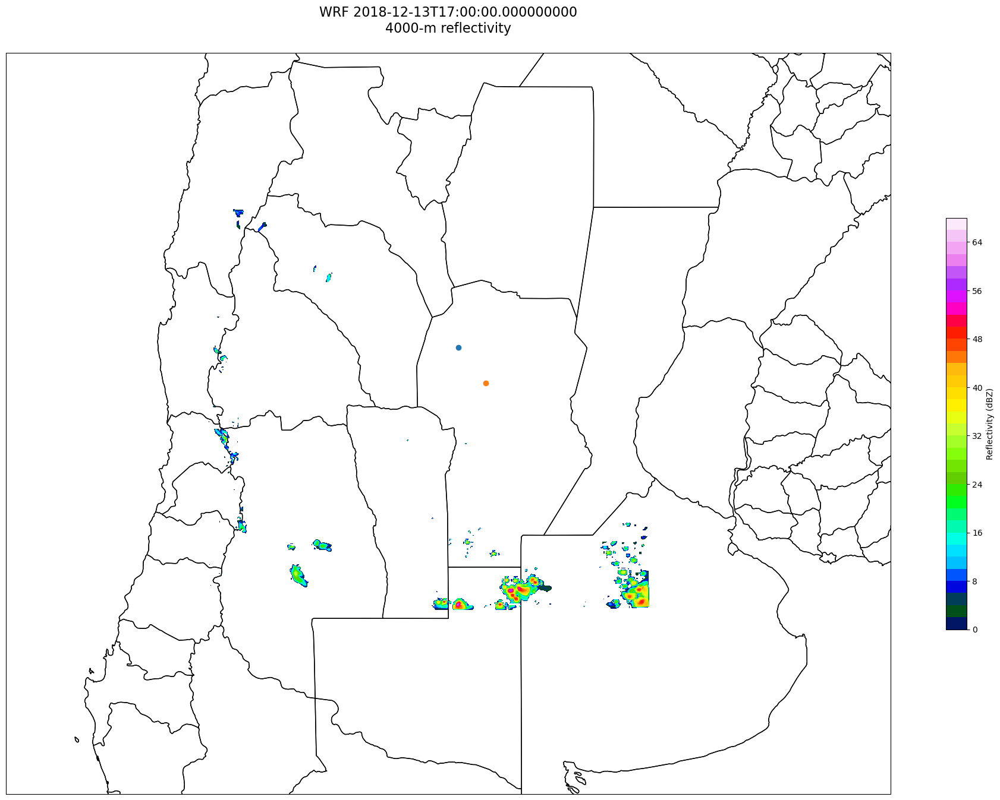

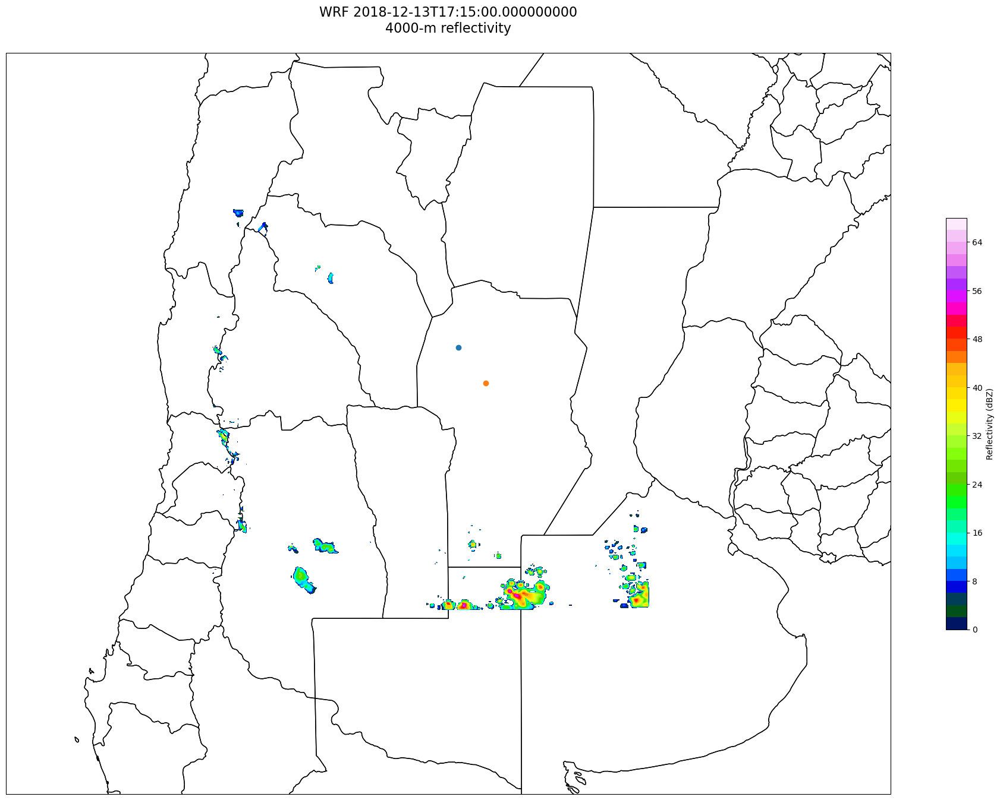

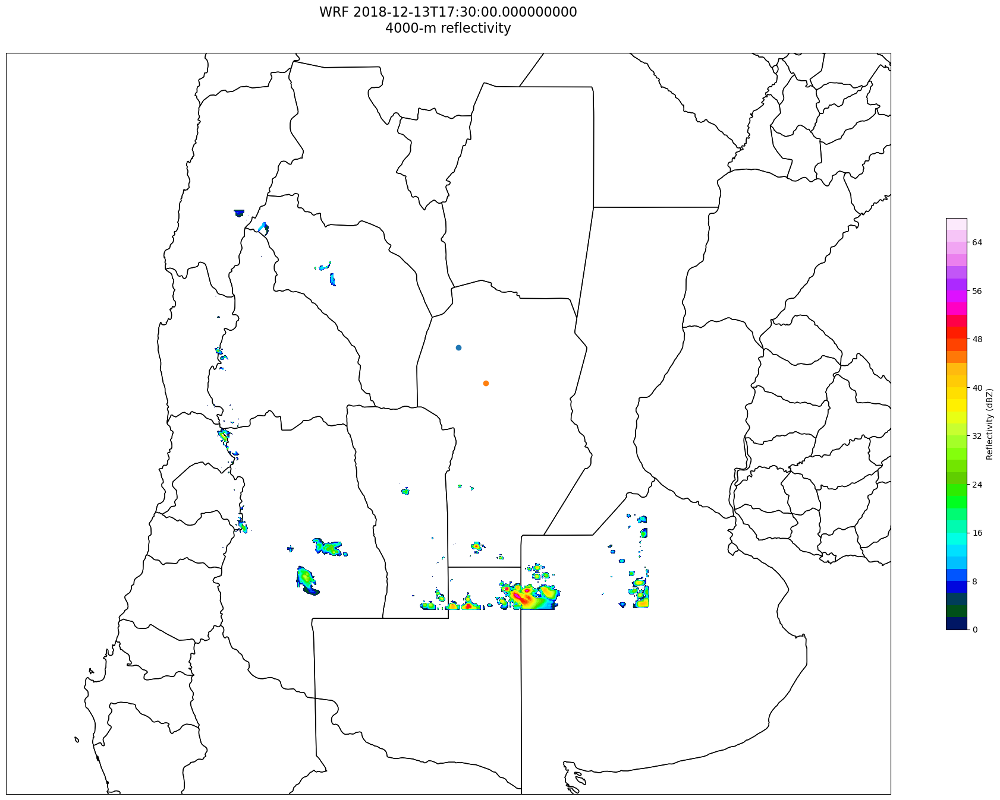

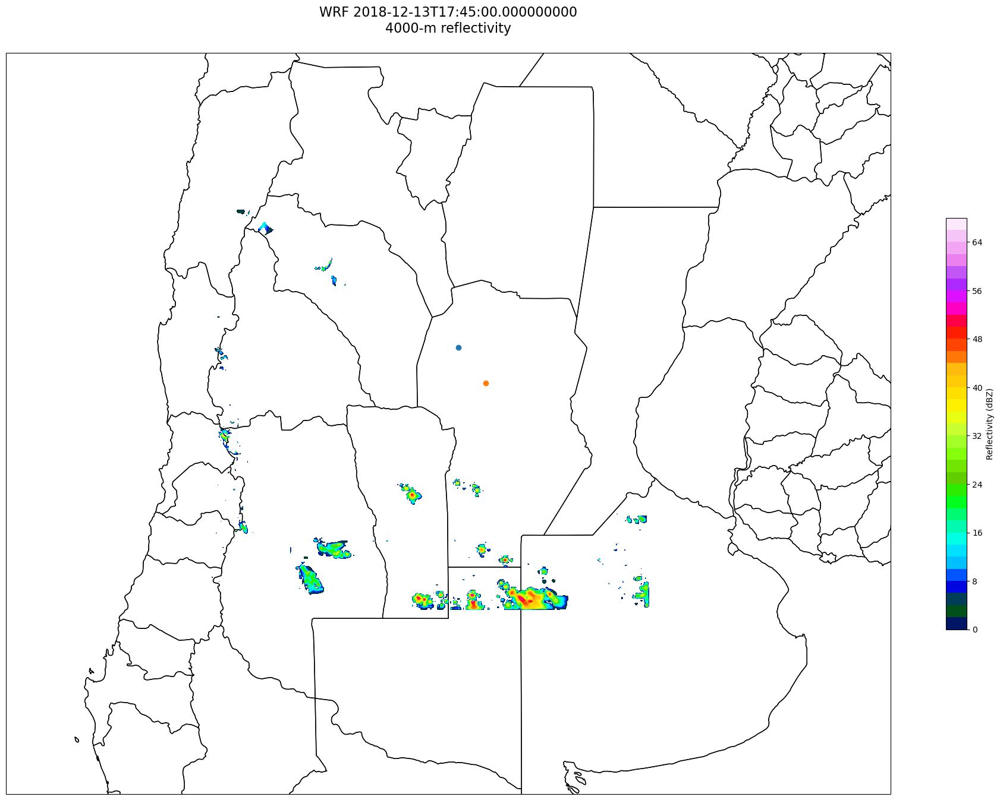

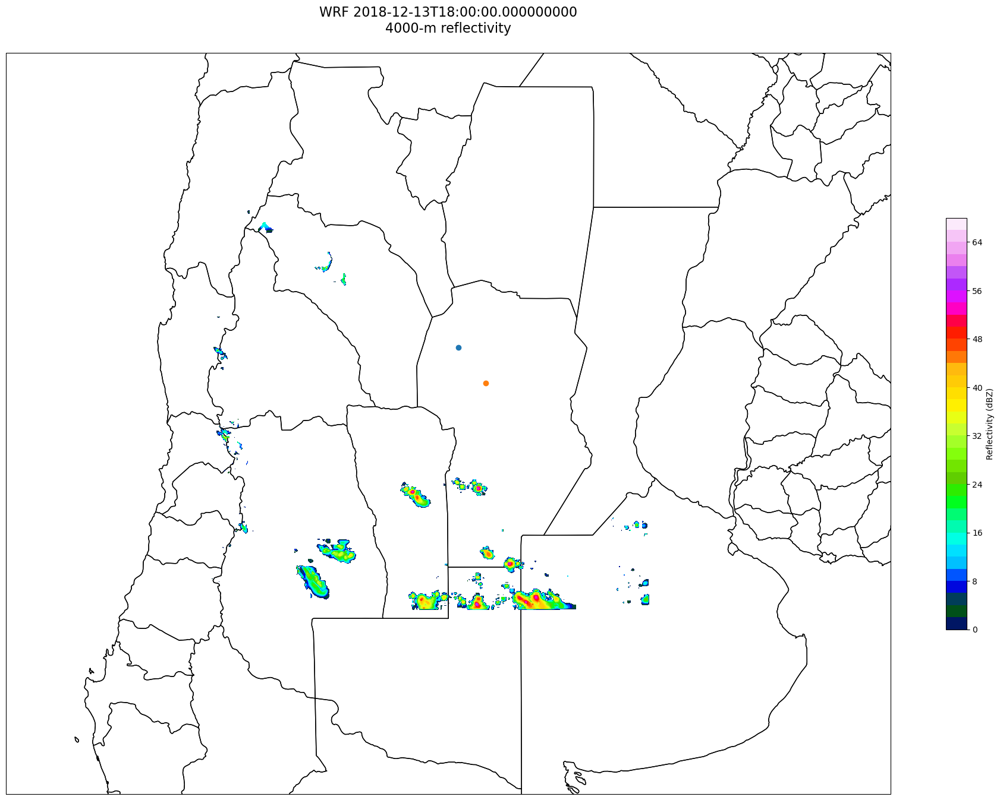

...

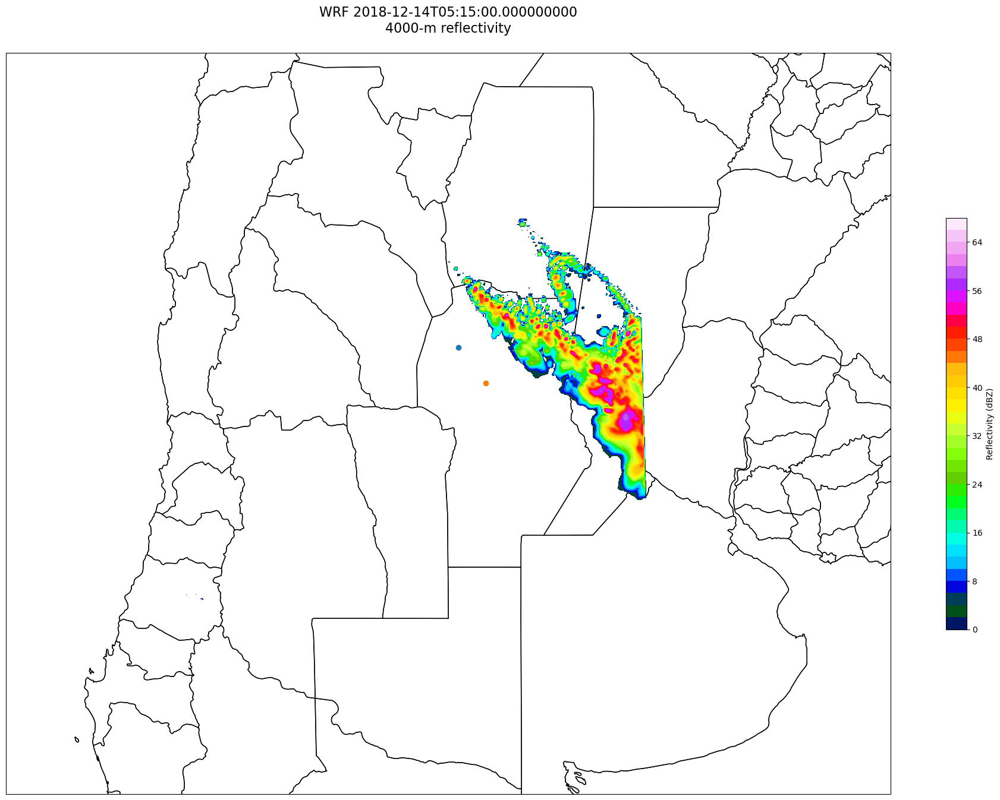

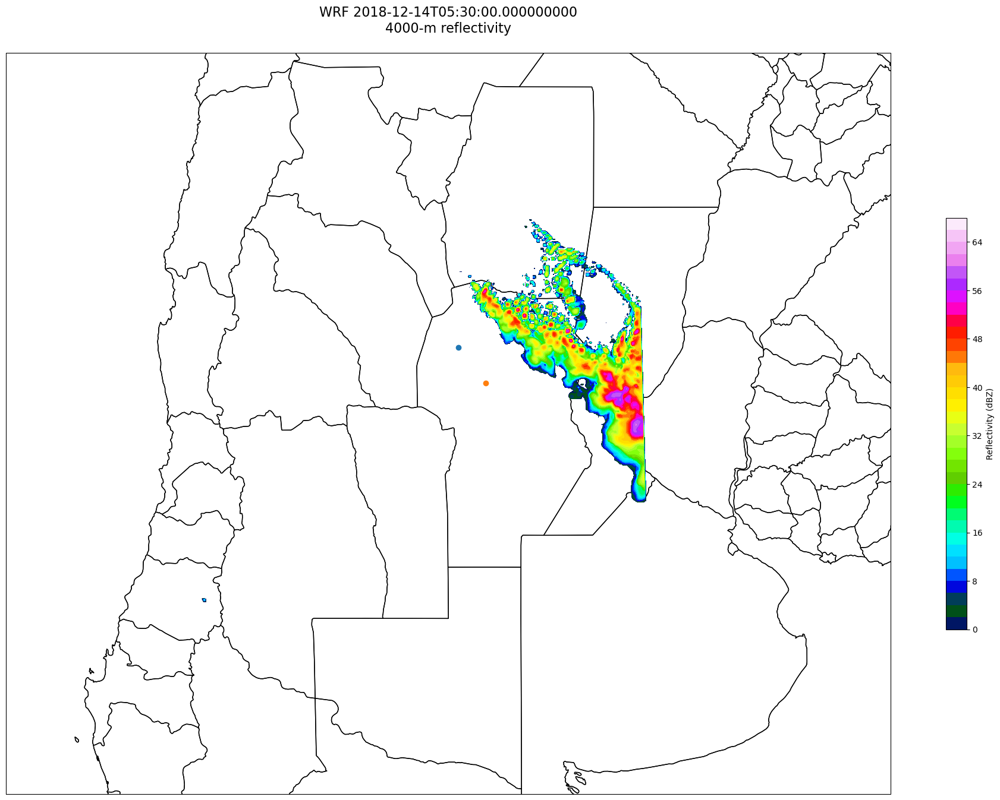

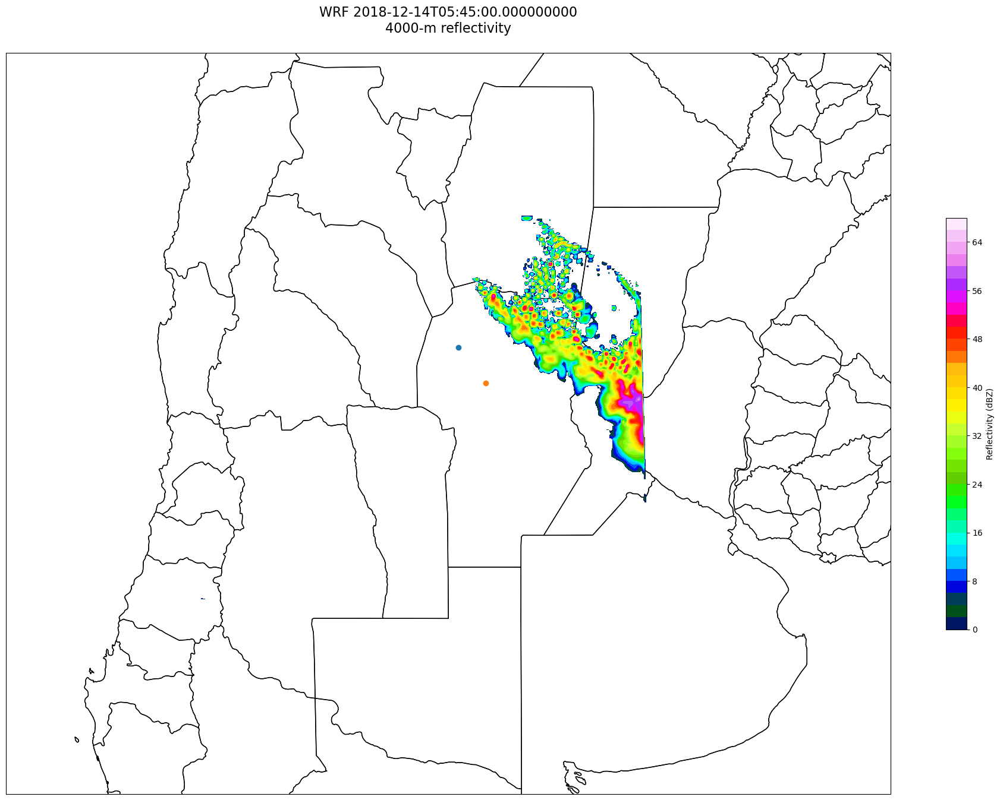

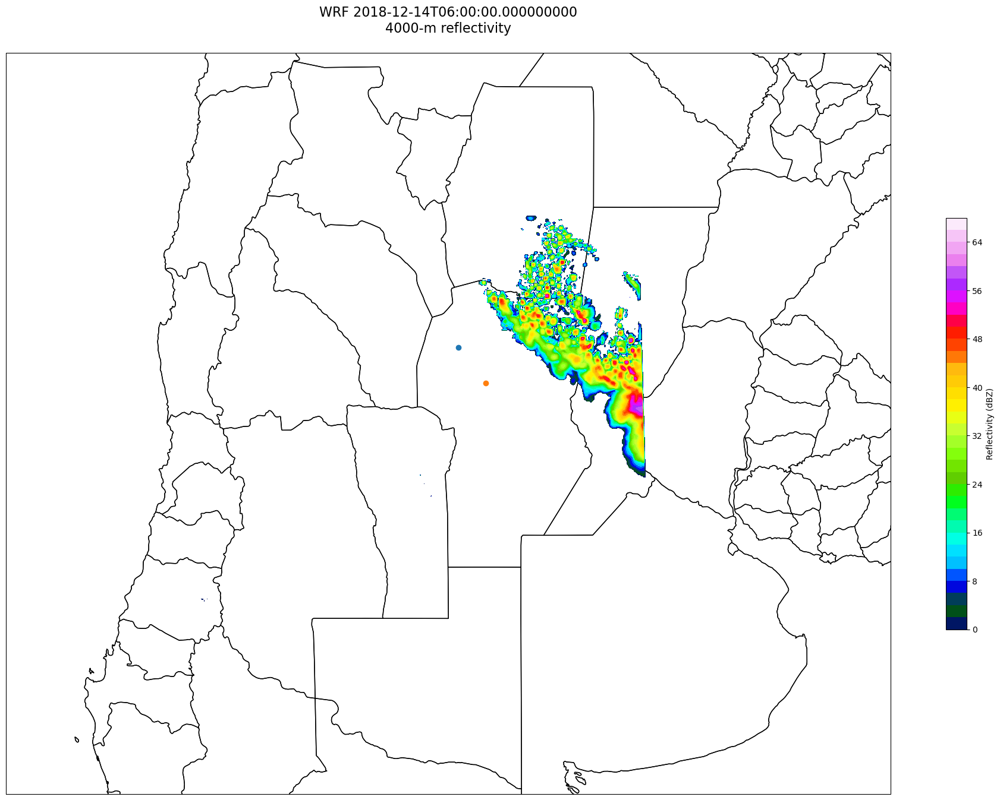

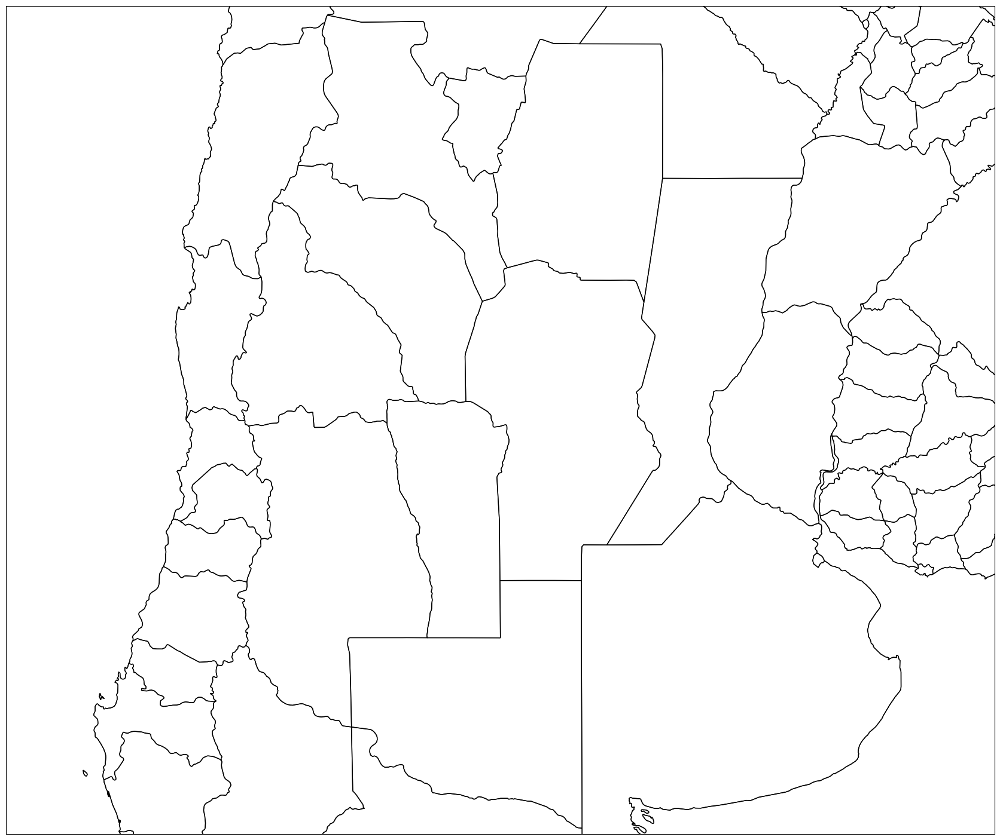

In [11]:
i=0
for value in time:
    fig = plt.figure(figsize=(24,18)) 
    ax = plt.subplot(1,1,1,projection=proj_map)
    ax.set_extent ([lonW+25,lonE-30,latS+41,latN-25])
    ax.add_feature(cf.COASTLINE.with_scale(res))
    ax.add_feature(cf.STATES.with_scale(res))
    
    tl1 = 'WRF ' + str(timelist[i])
    tl2 = '4000-m reflectivity'
    title_line = (tl1 + '\n' + tl2 + '\n')
    title = plt.title(title_line,fontsize=16)
    
    
    CF=ax.contourf(lon, lat, refl4.isel(Time=i), levels=np.arange(0,70,2), cmap='gist_ncar', zorder=2, transform=proj_data)
    cbar = fig.colorbar(CF,shrink=0.5)
    cbar.set_label(r'Reflectivity (dBZ)', size='medium')
    
    
    #ax.contourf(y.lon, y.lat, y, levels=np.arange(0,2890,10), cmap='Greys', transform=ccrs.PlateCarree(), zorder=1)
    
    ax.scatter(-64.8086, -30.7219, transform=proj_data)
    ax.scatter(-64.1888, -31.4201, transform=proj_data)
    
    #fig.savefig('refl4000m_wrf3km_' + str(i))
    
    i=i+1